In [84]:
!pip install ydata_profiling -q

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.6/390.6 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 27.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 48.5 MB/s eta 0:00:00


#Все импорты

In [85]:
from ydata_profiling import ProfileReport
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import pandas as pd
import numpy as np

#Подключение к г. диску, формирование датафреймов

In [78]:
data_path = '/content/drive/MyDrive/ML/COOKIE/info/data/'

df1 = pd.read_csv(data_path + 'act_dataset/телеметрия/data2024-06-01.csv')
df2 = pd.read_csv(data_path + 'act_dataset/телеметрия/data2024-08-23.csv')

#Вспомогательные функции

In [79]:
# corr matrix
def print_corr_matrix(df, title):
  num_df = df.select_dtypes(include=['number'])
  df_corr = round(num_df.corr(), 3)

  plt.figure(figsize=(20, 10))
  sns.heatmap(df_corr, annot=True, cmap='coolwarm')

  plt.title(title)
  plt.show()

#IQR outliers
def get_outliers_idx(df, feature):
  IQR = df[feature].quantile(0.75) - df[feature].quantile(0.25)
  low = df[feature].quantile(0.25) - (IQR * 1.5)
  up = df[feature].quantile(0.75) + (IQR * 1.5)
  borders = (low, up)
  outliers = pd.concat([df[feature] < low, df[feature] > up], axis=1)
  outliers_index = outliers.any(axis=1)
  return outliers_index

def print_box_plots(df):
  for column in df.columns:
    fig = px.box(df, y=column)
    fig.update_layout(title=column)
    fig.show()

#3-sigma
def three_sigma_otliners(df, feature):
  mean = df[feature].mean()
  std_dev = df[feature].std()
  lower_bound = mean - 3 * std_dev
  upper_bound = mean + 3 * std_dev

  outliers = pd.concat([df[feature] < lower_bound, df[feature] > upper_bound], axis=1)
  outliers_index = outliers.any(axis=1)
  return outliers_index

def drop_otliners(df, method):
  new_df = df

  for column in new_df.columns:
    if column == 't':
      continue

    if method == 'sigma':
      new_df = new_df[~three_sigma_otliners(new_df, column)]
    elif method == 'IQR':
      new_df = new_df[~get_outliers_idx(new_df, column)]
    else:
      print('Хуйню в параметры передал')

  new_df = new_df.reset_index(drop=True)
  return new_df

#EDA

In [80]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29731 entries, 0 to 29730
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   t                             29731 non-null  object 
 1   v_gas                         29731 non-null  float64
 2   v_pres_gauge                  29731 non-null  float64
 3   v_liq_flowrate                29731 non-null  float64
 4   p_atma                        29731 non-null  float64
 5   rl                            29731 non-null  float64
 6   rg                            29731 non-null  float64
 7   rm                            29731 non-null  float64
 8   mul                           29731 non-null  float64
 9   mum                           29731 non-null  float64
 10  mug                           29731 non-null  float64
 11  gf                            29731 non-null  float64
 12  stlg                          29731 non-null  float64
 13  s

In [81]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28045 entries, 0 to 28044
Data columns (total 25 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   t                             28045 non-null  object 
 1   v_gas                         28045 non-null  float64
 2   v_pres_gauge                  28045 non-null  float64
 3   v_liq_flowrate                28045 non-null  float64
 4   p_atma                        28045 non-null  float64
 5   rl                            28045 non-null  float64
 6   rg                            28045 non-null  float64
 7   rm                            28045 non-null  float64
 8   mul                           28045 non-null  float64
 9   mum                           28045 non-null  float64
 10  mug                           28045 non-null  float64
 11  gf                            28045 non-null  float64
 12  stlg                          28045 non-null  float64
 13  s

In [82]:
df1['t'] = pd.to_datetime(df1['t'])
df1.drop('rs', axis=1, inplace=True)
df1['t'] = df1['t'].apply(lambda x: x.strftime('%Y-%m-%d %H:%M:%S'))

df2['t'] = pd.to_datetime(df2['t'], format='mixed')
df2.drop('rs', axis=1, inplace=True)
df2['t'] = df2['t'].apply(lambda x: x.strftime('%Y-%m-%d %H:%M:%S'))

In [83]:
df1

,t,v_gas,v_pres_gauge,v_liq_flowrate,p_atma,rl,rg,rm,mul,mum,...,liquid_flowrate_m3day,gas_flowrate_m3day,qm_m3day,superficial_liquid_velocity,superficial_gas_velocity,superficial_mixture_velocity,Re_liq_value,Re_mix_value,Fr_value,We_value
0,2024-06-01 11:33:26,0.0,1.100390,0.000000,2.100390,998.458176,1.756769,998.458176,0.973860,0.973860,...,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
1,2024-06-01 11:36:55,0.0,1.100390,5.942605,2.100390,998.458176,1.756769,998.458176,0.973860,0.973860,...,5.951782,0.0,5.951782,0.035084,0.0,0.035084,1798.485407,1798.485407,0.002509,0.870795
2,2024-06-01 11:39:46,0.0,1.100390,0.000000,2.100390,998.458176,1.756769,998.458176,0.973860,0.973860,...,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
3,2024-06-01 11:46:06,0.0,1.102840,0.000000,2.102840,998.458194,1.758831,998.458194,0.973861,0.973861,...,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
4,2024-06-01 12:30:47,0.0,1.114738,47.289421,2.114738,998.458283,1.768847,998.458283,0.973868,0.973868,...,47.362441,0.0,47.362441,0.279184,0.0,0.279184,14311.669885,14311.669885,0.158907,55.143258
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29726,2024-06-01 18:06:57,0.0,1.014998,9.583998,2.014998,998.457543,1.684912,998.457543,0.973810,0.973810,...,9.598803,0.0,9.598803,0.056581,0.0,0.056581,2900.672981,2900.672981,0.006527,2.264853
29727,2024-06-01 18:07:01,0.0,1.016748,92.969490,2.016748,998.457556,1.686383,998.457556,0.973811,0.973811,...,93.113112,0.0,93.113112,0.548867,0.0,0.548867,28137.924802,28137.924802,0.614180,213.121821
29728,2024-06-01 18:07:02,0.0,1.016398,174.353485,2.016398,998.457553,1.686089,998.457553,0.973811,0.973811,...,174.622832,0.0,174.622832,1.029337,0.0,1.029337,52769.422217,52769.422217,2.160110,749.563145
29729,2024-06-01 18:07:03,0.0,1.011849,301.425903,2.011849,998.457519,1.682262,998.457519,0.973808,0.973808,...,301.891565,0.0,301.891565,1.779538,0.0,1.779538,91229.112900,91229.112900,6.456181,2240.305748


#Матрицы корреляции по дням

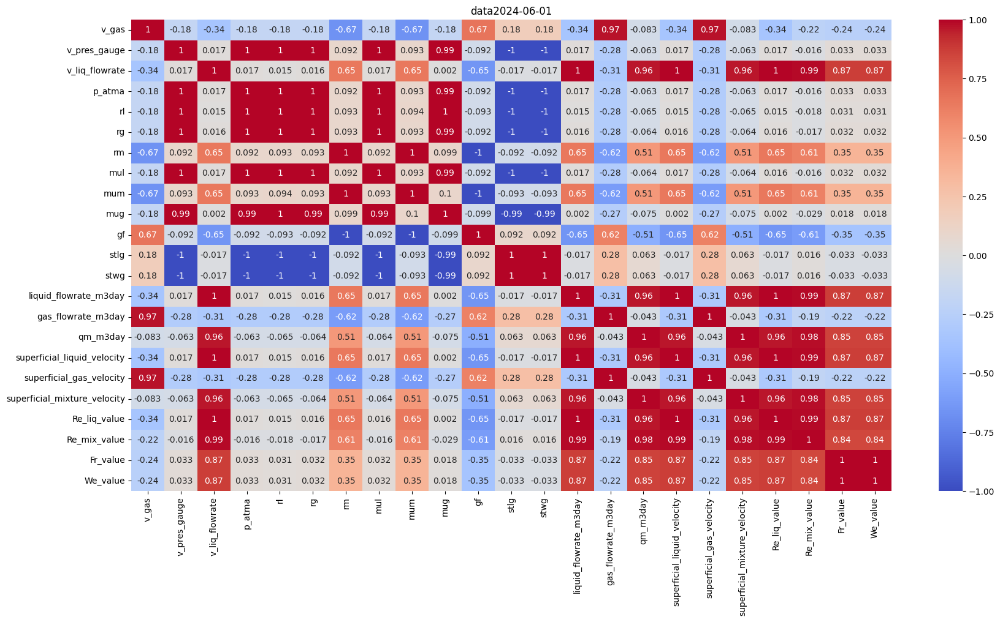

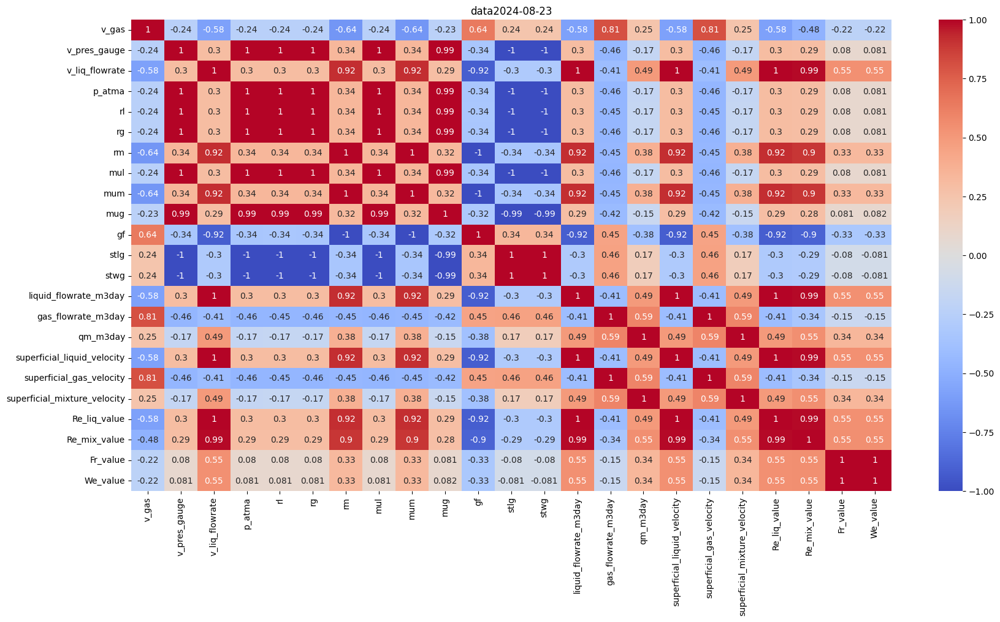

In [43]:
print_corr_matrix(df1, 'data2024-06-01')
print_corr_matrix(df2, 'data2024-08-23')

<ipython-input-44-616200df071d>:7: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



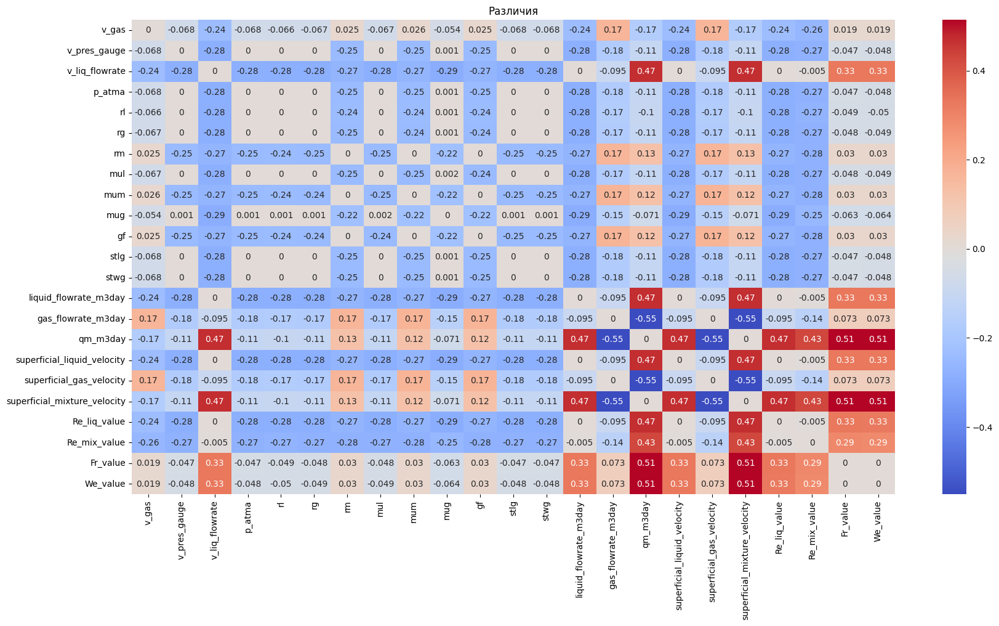

In [44]:
num_df1 = df1.select_dtypes(include=['number'])
df_corr1 = round(num_df1.corr(), 3)

num_df2 = df2.select_dtypes(include=['number'])
df_corr2 = round(num_df2.corr(), 3)

df_corr = df_corr1.applymap(abs) - df_corr2.applymap(abs)

plt.figure(figsize=(20, 10))
sns.heatmap(df_corr, annot=True, cmap='coolwarm')

plt.title('Различия корреляций df1 и df2')
plt.show()

In [45]:
(df1 == 0).sum()

,0
t,0
v_gas,13556
v_pres_gauge,0
v_liq_flowrate,9381
p_atma,0
rl,0
rg,0
rm,0
mul,0
mum,0


In [46]:
(df2 == 0).sum()

,0
t,0
v_gas,15111
v_pres_gauge,0
v_liq_flowrate,8686
p_atma,0
rl,0
rg,0
rm,0
mul,0
mum,0


*   mum - вязкость смеси, сП
*   gf - содержание газа в потоке, д,ед.
*   liquid_flowrate_m3day – расход жидкости в местных условиях, м3/сут
*   gas_flowrate_m3day - расход газа в местных условиях, м3/сут
*   qm_m3day - расход смеси в местных условиях, м3/сут
*   superficial_mixture_velocity - приведенная скорость смеси, м/с
*   Re_liq_value - число Рейнольдса для жидкости
*   Fr_value - число Фруда для смеси
*   We_value - число Вебера для смеси


Все нули логически обоснованы






##Обработка выбросов для df1 (data2024-06-01)

###До обработки

In [47]:
print_box_plots(df1)

Output hidden; open in https://colab.research.google.com to view.

###Метод трёх сигм

In [48]:
sigma_no_outliners_df1 = drop_otliners(df1, 'sigma')

In [49]:
sigma_no_outliners_df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27245 entries, 0 to 27244
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   t                             27245 non-null  datetime64[ns]
 1   v_gas                         27245 non-null  float64       
 2   v_pres_gauge                  27245 non-null  float64       
 3   v_liq_flowrate                27245 non-null  float64       
 4   p_atma                        27245 non-null  float64       
 5   rl                            27245 non-null  float64       
 6   rg                            27245 non-null  float64       
 7   rm                            27245 non-null  float64       
 8   mul                           27245 non-null  float64       
 9   mum                           27245 non-null  float64       
 10  mug                           27245 non-null  float64       
 11  gf                          

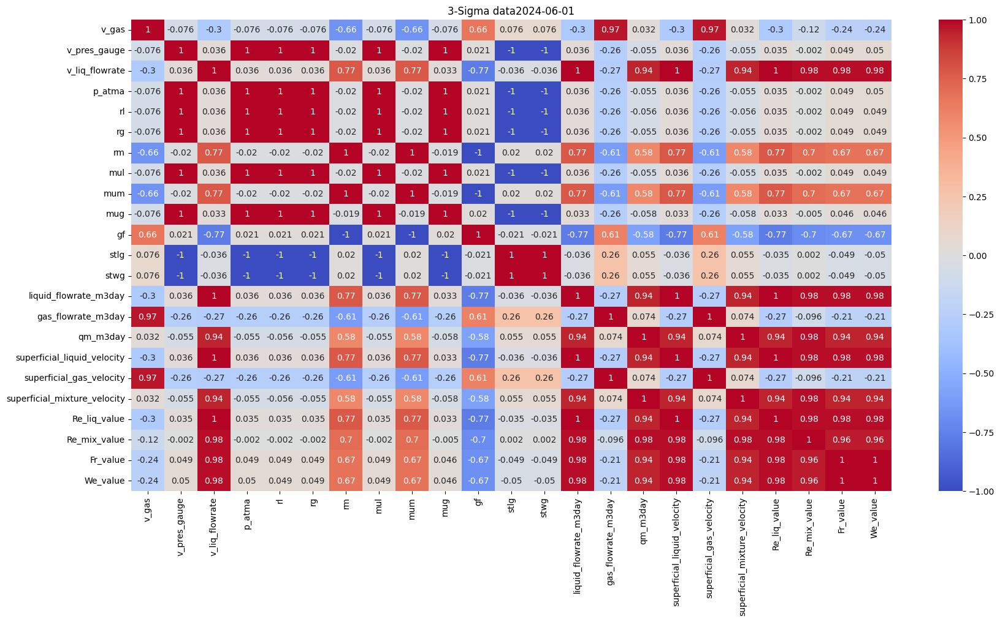

In [50]:
num_sigma_no_outliners_df1 = sigma_no_outliners_df1.drop('t', axis = 1)

print_corr_matrix(num_sigma_no_outliners_df1, '3-Sigma data2024-06-01')

In [51]:
print_box_plots(num_sigma_no_outliners_df1)

Output hidden; open in https://colab.research.google.com to view.

###IQR

In [52]:
iqr_no_outliners_df1 = drop_otliners(df1, 'IQR')

In [53]:
iqr_no_outliners_df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27287 entries, 0 to 27286
Data columns (total 24 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   t                             27287 non-null  datetime64[ns]
 1   v_gas                         27287 non-null  float64       
 2   v_pres_gauge                  27287 non-null  float64       
 3   v_liq_flowrate                27287 non-null  float64       
 4   p_atma                        27287 non-null  float64       
 5   rl                            27287 non-null  float64       
 6   rg                            27287 non-null  float64       
 7   rm                            27287 non-null  float64       
 8   mul                           27287 non-null  float64       
 9   mum                           27287 non-null  float64       
 10  mug                           27287 non-null  float64       
 11  gf                          

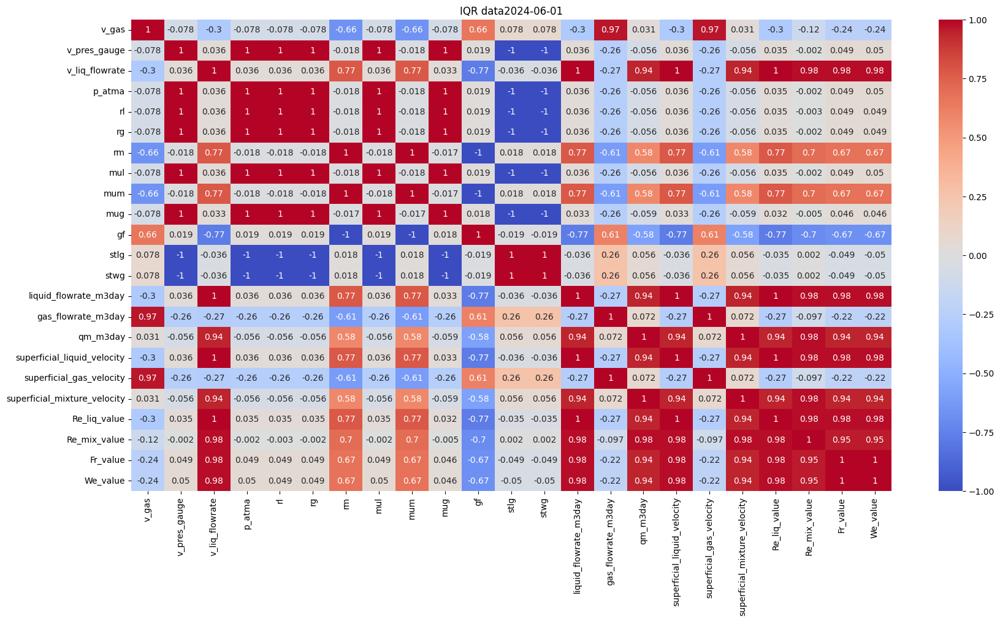

In [54]:
num_iqr_no_outliners_df1 = iqr_no_outliners_df1.drop('t', axis = 1)

print_corr_matrix(num_iqr_no_outliners_df1, 'IQR data2024-06-01')

In [55]:
print_box_plots(num_iqr_no_outliners_df1)

Output hidden; open in https://colab.research.google.com to view.

Будем использовать метод трёх сигм

In [56]:
df1 = sigma_no_outliners_df1

##Обработка выбросов для df2 (data2024-08-23)

In [57]:
df2 = drop_otliners(df2, 'sigma')

In [58]:
print_box_plots(df2)

Output hidden; open in https://colab.research.google.com to view.

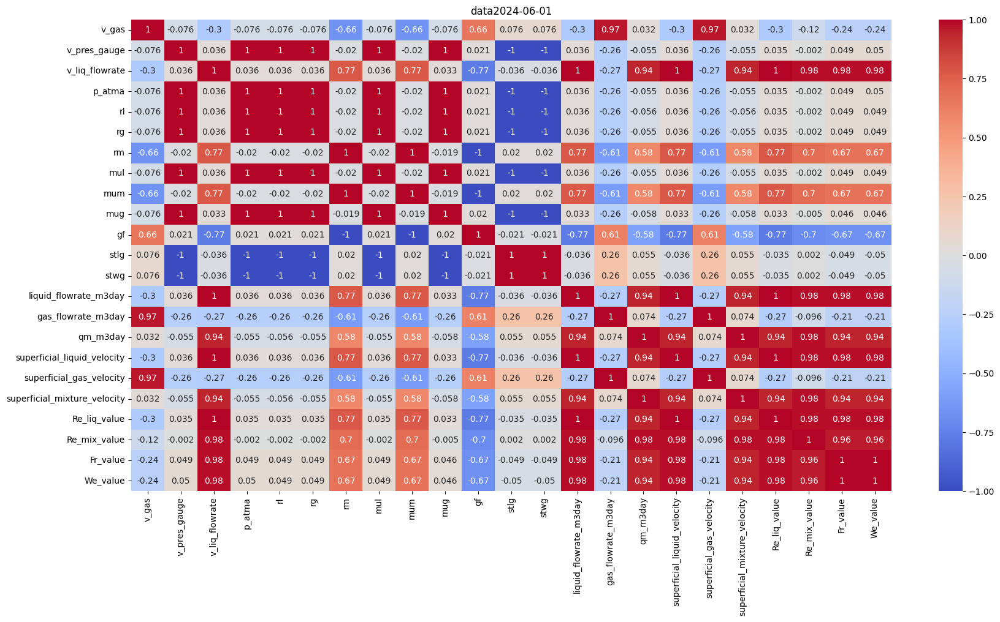

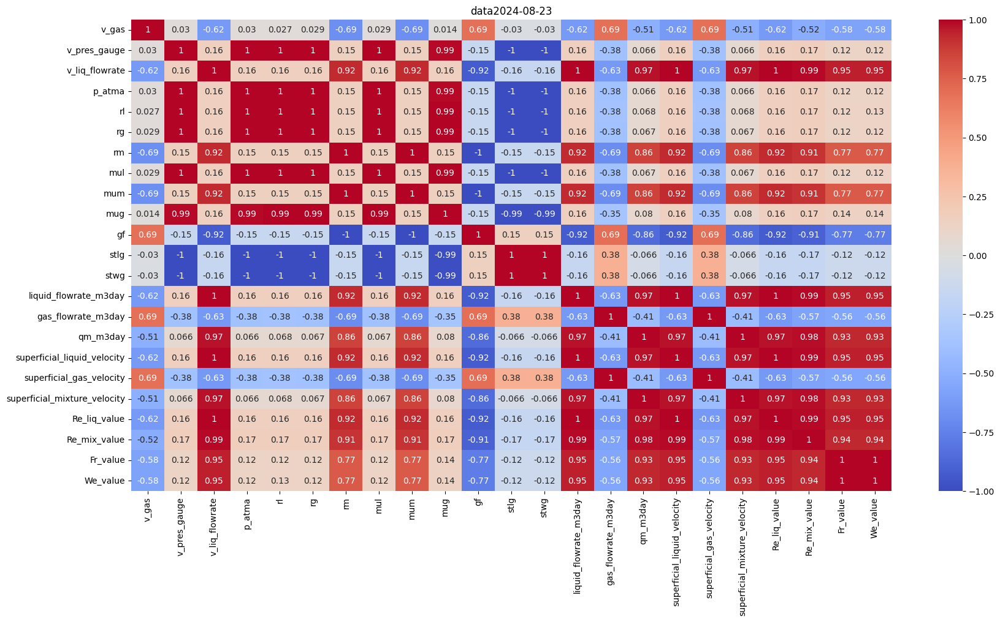

In [59]:
print_corr_matrix(df1, 'data2024-06-01')
print_corr_matrix(df2, 'data2024-08-23')

<ipython-input-61-616200df071d>:7: FutureWarning:

DataFrame.applymap has been deprecated. Use DataFrame.map instead.



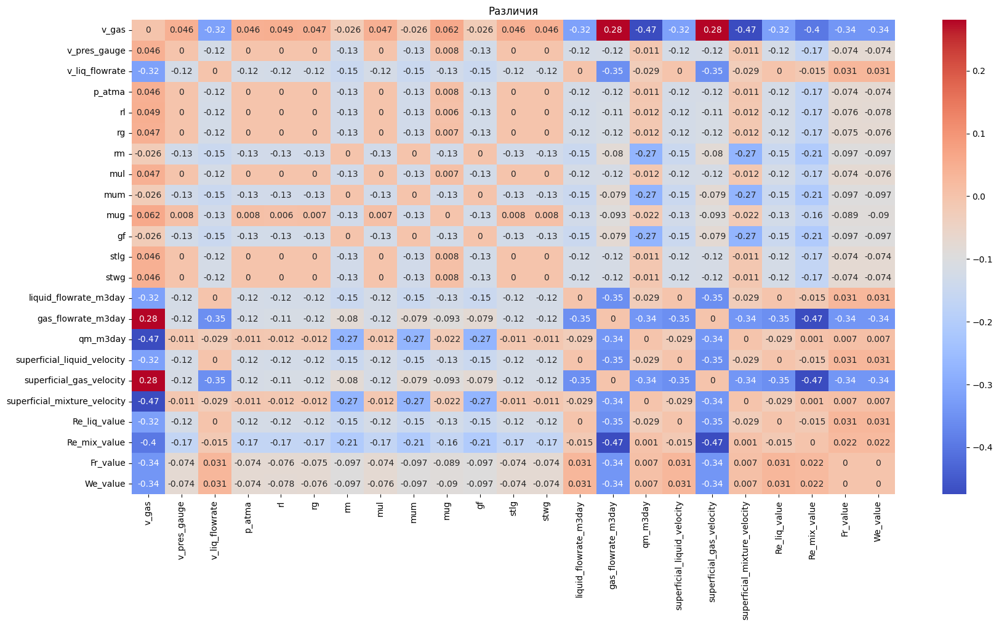

In [61]:
num_df1 = df1.select_dtypes(include=['number'])
df_corr1 = round(num_df1.corr(), 3)

num_df2 = df2.select_dtypes(include=['number'])
df_corr2 = round(num_df2.corr(), 3)

df_corr = df_corr1.applymap(abs) - df_corr2.applymap(abs)

plt.figure(figsize=(20, 10))
sns.heatmap(df_corr, annot=True, cmap='coolwarm')

plt.title('Различия')
plt.show()

###Общаяя сводка ProfileReport

In [86]:
profile = ProfileReport(df1, title="Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#Сохранение датафреймов в CSV

In [60]:
# stand2_df.to_csv('stand2_df.csv')